Found 1737 images belonging to 7 classes.
109/109 [==============================] - 54s 267ms/step - loss: 0.1794 - accuracy: 0.9476

Test Loss: 0.1794
Test Accuracy: 0.9476
109/109 [==============================] - 15s 127ms/step


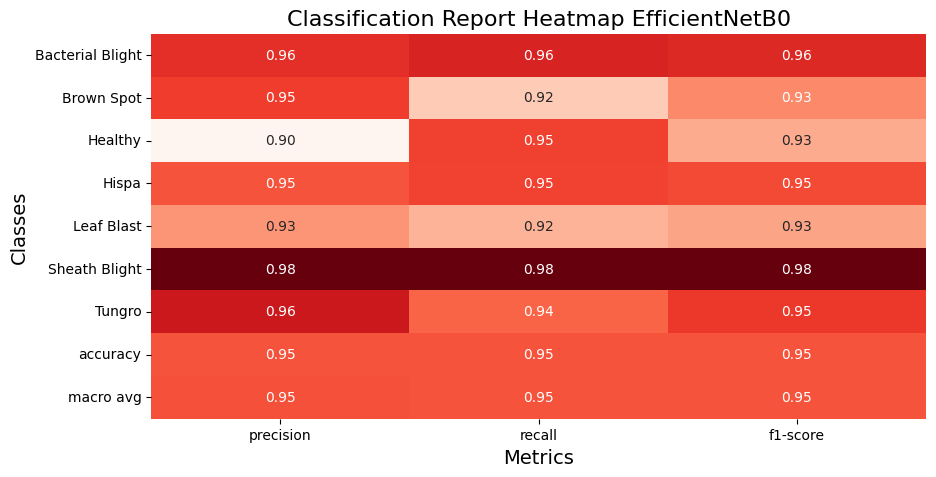

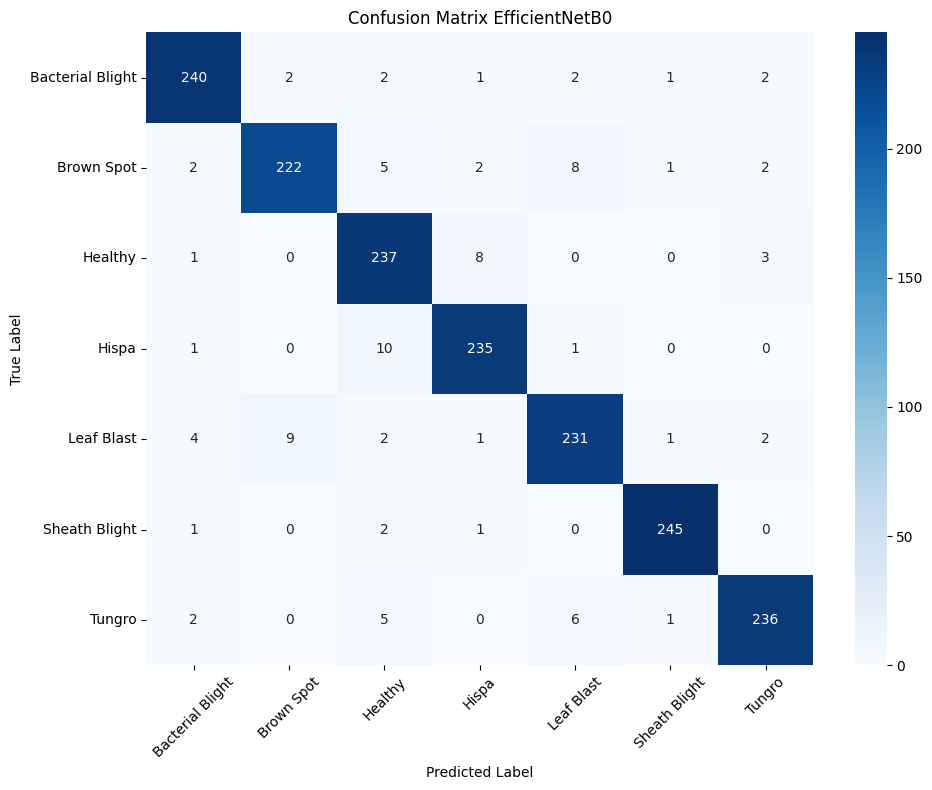

In [1]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Rebuild the model architecture
base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(7, activation='softmax')(x)  # Adjust to the number of classes

model = Model(inputs=base_model.input, outputs=predictions)

# Load the model weights
model.load_weights(r'D:\\CADT\\CapstoneProjectI\\ml__model\\models\\efficientnetb0_weights.h5')

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Test directory
test_dir = r'D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test'

# Image dimensions and batch size
IMAGE_SIZE = (224, 224)
BATCH_SIZE = 16

# Test data generator
test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=IMAGE_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# Evaluate the model
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"\nTest Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

# Get predictions
test_generator.reset()
predictions = model.predict(test_generator)
predicted_classes = np.argmax(predictions, axis=1)
true_classes = test_generator.classes

# Get class labels
class_labels = list(test_generator.class_indices.keys())

# Classification report
report = classification_report(true_classes, predicted_classes, target_names=class_labels, output_dict=True)
report_df = pd.DataFrame(report).transpose()

# Plot Classification Report Heatmap
plt.figure(figsize=(10, 5))
sns.heatmap(report_df.iloc[:-1, :-1], annot=True, cmap=plt.cm.Reds, fmt=".2f", cbar=False)
plt.title('Classification Report Heatmap EfficientNetB0', fontsize=16)
plt.xlabel('Metrics', fontsize=14)
plt.ylabel('Classes', fontsize=14)
plt.show()

# Confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

# Visualize confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=class_labels,
            yticklabels=class_labels)
plt.title('Confusion Matrix EfficientNetB0')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

109/109 [==============================] - 19s 179ms/step

Misclassified Images:
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0169.jpg, True Class: Bacterial Blight, Predicted Class: Hispa
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0238.jpg, True Class: Bacterial Blight, Predicted Class: Healthy
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0299.jpg, True Class: Bacterial Blight, Predicted Class: Healthy
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0464.jpg, True Class: Bacterial Blight, Predicted Class: Tungro
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0465.jpg, True Class: Bacterial Blight, Predicted Class: Sheath Blight
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blig

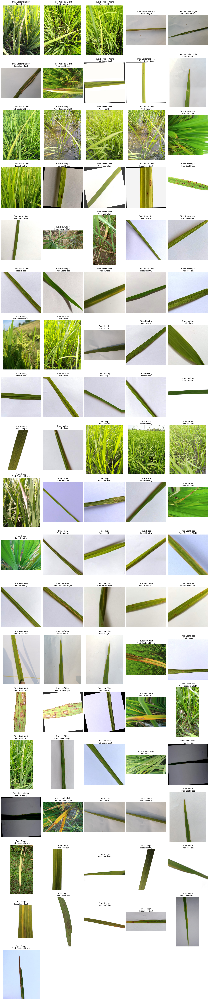

In [ ]:
# Get file paths for each image in the test generator
test_generator.reset()  # Reset generator to start
file_paths = test_generator.filepaths  # Get the file paths from the generator

# Get predictions
predictions = model.predict(test_generator)
predicted_classes = np.argmax(predictions, axis=1)
true_classes = test_generator.classes

# Identify misclassified images
misclassified_indices = np.where(predicted_classes != true_classes)[0]
misclassified_images = [file_paths[i] for i in misclassified_indices]
misclassified_predictions = [predicted_classes[i] for i in misclassified_indices]
misclassified_true_classes = [true_classes[i] for i in misclassified_indices]

# Print misclassified images with their true and predicted labels
print("\nMisclassified Images:")
for i in range(len(misclassified_images)):
    print(f"Image: {misclassified_images[i]}, "
          f"True Class: {class_labels[misclassified_true_classes[i]]}, "
          f"Predicted Class: {class_labels[misclassified_predictions[i]]}")

# Optionally, you can display all misclassified images
import matplotlib.pyplot as plt

# Number of misclassified images
num_misclassified = len(misclassified_images)

# Set up the figure size based on the number of misclassified images
cols = 20  # Number of columns
rows = (num_misclassified + cols - 1) // cols  # Calculate rows needed

plt.figure(figsize=(30, rows * 3))  # Adjust height based on number of rows

for i, img_path in enumerate(misclassified_images):  # Loop through all misclassified images
    img = plt.imread(img_path)
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img)
    plt.title(f"True: {class_labels[misclassified_true_classes[i]]}\nPred: {class_labels[misclassified_predictions[i]]}")
    plt.axis('off')

plt.tight_layout()
plt.show()

109/109 [==============================] - 15s 137ms/step

Misclassified Images:
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0169.jpg, True Class: Bacterial Blight, Predicted Class: Hispa
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0238.jpg, True Class: Bacterial Blight, Predicted Class: Healthy
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0299.jpg, True Class: Bacterial Blight, Predicted Class: Healthy
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0464.jpg, True Class: Bacterial Blight, Predicted Class: Tungro
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blight_0465.jpg, True Class: Bacterial Blight, Predicted Class: Sheath Blight
Image: D:\CADT\CapstoneProjectI\ml__model\data\splited_data\test\Bacterial Blight\bacterial blig

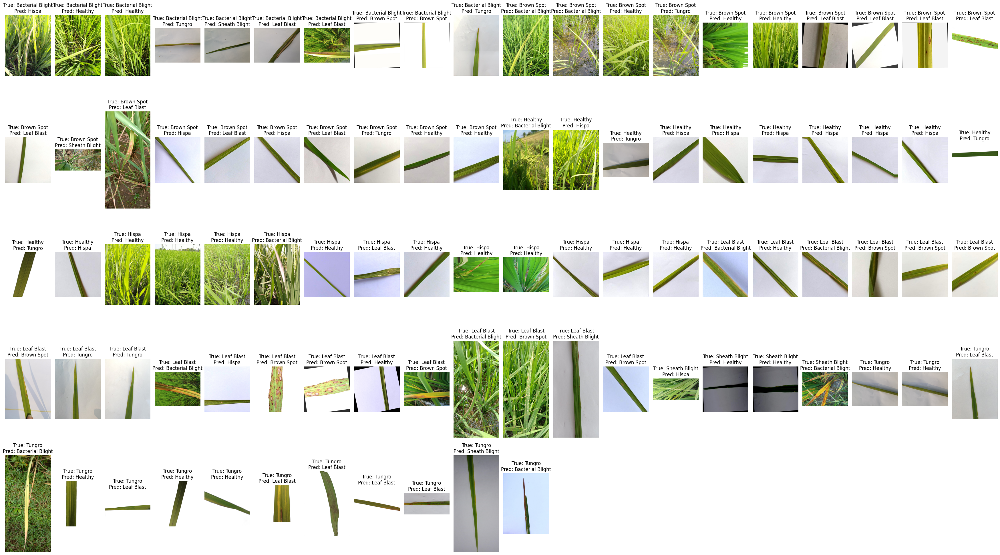

In [6]:
# Get file paths for each image in the test generator
test_generator.reset()  # Reset generator to start
file_paths = test_generator.filepaths  # Get the file paths from the generator

# Get predictions
predictions = model.predict(test_generator)
predicted_classes = np.argmax(predictions, axis=1)
true_classes = test_generator.classes

# Identify misclassified images
misclassified_indices = np.where(predicted_classes != true_classes)[0]
misclassified_images = [file_paths[i] for i in misclassified_indices]
misclassified_predictions = [predicted_classes[i] for i in misclassified_indices]
misclassified_true_classes = [true_classes[i] for i in misclassified_indices]

# Print misclassified images with their true and predicted labels
print("\nMisclassified Images:")
for i in range(len(misclassified_images)):
    print(f"Image: {misclassified_images[i]}, "
          f"True Class: {class_labels[misclassified_true_classes[i]]}, "
          f"Predicted Class: {class_labels[misclassified_predictions[i]]}")

# Optionally, you can display all misclassified images
import matplotlib.pyplot as plt

# Number of misclassified images
num_misclassified = len(misclassified_images)

# Set up the figure size based on the number of misclassified images
cols = 20  # Number of columns
rows = (num_misclassified + cols - 1) // cols  # Calculate rows needed

plt.figure(figsize=(35, rows * 4))  # Adjust height based on number of rows

for i, img_path in enumerate(misclassified_images):  # Loop through all misclassified images
    img = plt.imread(img_path)
    plt.subplot(rows, cols, i + 1)
    plt.imshow(img)
    plt.title(f"True: {class_labels[misclassified_true_classes[i]]}\nPred: {class_labels[misclassified_predictions[i]]}")
    plt.axis('off')

plt.tight_layout()
plt.show()